# Audience-based news source characterization using probabilistic recommendation system

## Data Handling

First we load all our data and create our big matrix $Y$

In [22]:
data_paths = ["data/ns_subreddit_2021-01.json", "data/ns_subreddit_2021-02.json", "data/ns_subreddit_2021-03.json", 
              "data/ns_subreddit_2021-04.json", "data/ns_subreddit_2021-05.json", "data/ns_subreddit_2021-06.json",]

In [23]:
data_path = data_paths[0]
data_path

'data/ns_subreddit_2021-01.json'

In [24]:
import json
import plotly.express as px
import numpy as np
import pandas as pd
from collections import Counter

In [25]:
current_dict = json.load(open(data_path))
len(current_dict)

1529

In [26]:
current_dict['wikipedia.org']['German']

[9, 7.109999999999999, 68]

In [27]:
# only get the counts 
for ns in current_dict.keys():
    for sr in current_dict[ns]:
        current_dict[ns][sr] = current_dict[ns][sr][0]

In [28]:
current_dict['wikipedia.org']['German']

9

In [29]:
current_dict = dict()

In [30]:
for path in data_paths:
    nssr = json.load(open(path))
    newssources = nssr.keys()
    for ns in newssources:
        subreddits = nssr[ns].keys()
        for sr in subreddits:
            if ns in current_dict and sr in current_dict[ns]:
                current_dict[ns][sr] += nssr[ns][sr][0]
            elif ns in current_dict:
                current_dict[ns][sr] = 1
            else:
                current_dict[ns] = dict()
                current_dict[ns][sr] = 1
    print(f"done for {path}")

done for data/ns_subreddit_2021-01.json
done for data/ns_subreddit_2021-02.json
done for data/ns_subreddit_2021-03.json
done for data/ns_subreddit_2021-04.json
done for data/ns_subreddit_2021-05.json
done for data/ns_subreddit_2021-06.json


In [31]:
# subreddits_id = json.load(open("data/subreddits_id2189.json"))
# id_subreddits = json.load(open("data/id_subreddits2189.json"))
# newssources_id = json.load(open("data/newssources_id2647.json"))
# id_newssources = json.load(open("data/id_newssources2647.json"))

# newssources2647 = set(newssources_id.keys())
# subreddits2189 = set(subreddits_id.keys())

# # newssources2647

In [32]:
# ns_included = set()
# sr_included = set()

# for path in data_paths:
#     nssr = json.load(open(path))
#     newssources = nssr.keys()
#     for ns in newssources:
#         if ns not in newssources2647:
#             continue
#         else:
#             ns_included.add(ns)
#             subreddits = nssr[ns].keys()
#             for sr in subreddits:
#                 sr_included.add(sr)
#                 if sr not in subreddits2189:
#                     sr_included.remove(sr)
#                     continue
#                 elif ns in current_dict and sr in current_dict[ns]:
#                     # add count
#                     current_dict[ns][sr] += nssr[ns][sr][0]
#                 elif ns in current_dict:
#                     # current_dict[ns][sr] = 1
#                     current_dict[ns][sr] = nssr[ns][sr][0]
#                 else:
#                     current_dict[ns] = dict()
#                     # current_dict[ns][sr] = 1
#                     current_dict[ns][sr] = nssr[ns][sr][0]

In [33]:
# len(ns_included), len(sr_included)

In [35]:
len(current_dict)

1597

In [36]:
df = pd.DataFrame.from_dict(current_dict)

In [40]:
df.shape

(108575, 1597)

In [41]:
newssources = list(current_dict.keys())
newssources[:5]

['wikipedia.org', 'espn.com', 'yahoo.com', 'reuters.com', 'sbs.com.au']

## Preliminary looks at the data

In [42]:
subreddits = set() 
for ns in newssources:
    subreddits = subreddits | set(current_dict[ns].keys())

In [43]:
len(subreddits)

108575

In [44]:
total_newssources = len(current_dict.keys())
total_newssources

1597

In [45]:
ratings = list() 
for ns in newssources:
    ratings = ratings + list(current_dict[ns].values())

In [46]:
ratings = np.array(ratings)

In [47]:
ratings[:5]

array([ 1, 13,  4,  4,  4])

In [48]:
len(ratings)

505638

In [49]:
max(ratings)

473429

In [58]:
top100ratings = sorted(ratings, reverse=True)[:100]

In [67]:
import statistics

In [51]:
np.mean(ratings)

10.681485568727034

In [70]:
np.median(ratings)

1.0

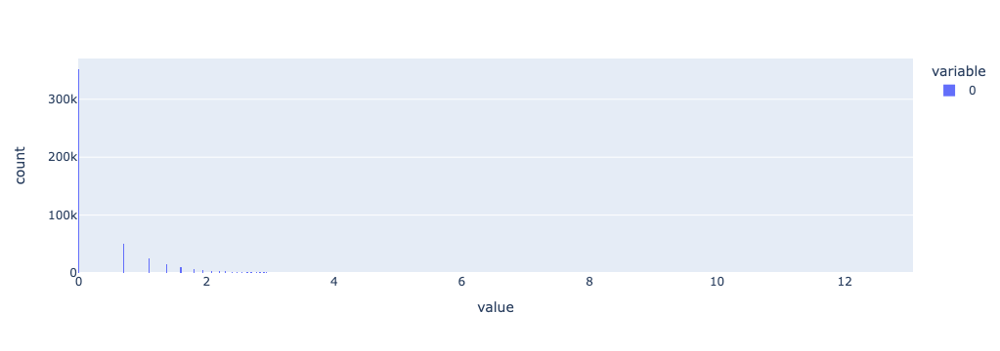

In [54]:
fig = px.histogram(np.log(ratings))
fig.show()

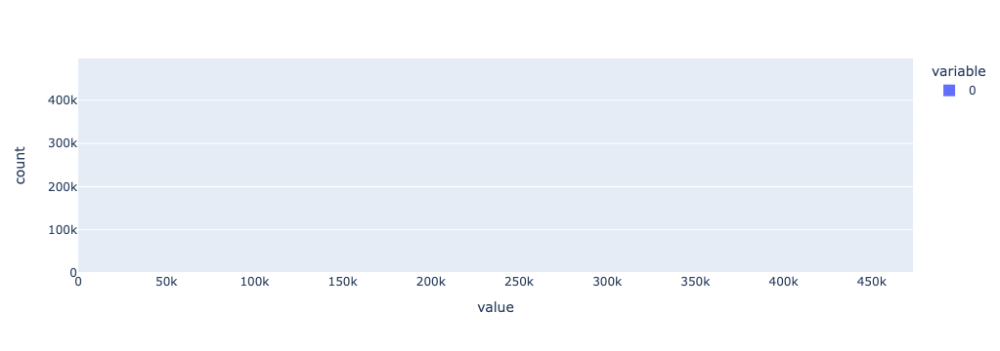

In [56]:
fig1 = px.histogram(ratings)
fig1.show()

In [ ]:
new_ratings = []
for rating in ratings:
    if rating > 0 and rating <= 

In [53]:
df = pd.DataFrame.from_dict(current_dict)
df = df.fillna(0)

In [146]:
df.head()

,wikipedia.org,espn.com,yahoo.com,reuters.com,sbs.com.au,cnn.com,engadget.com,blogspot.com,rt.com,theatlantic.com,...,dbrnews.com,theskimm.com,foxreno.com,sunlightfoundation.com,muncievoice.com,the-daily.buzz,thetowntalk.com,sonorannews.com,worldpress.org,conservativefreepress.com
RidiculousKanji,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
teslamotors,13.0,0.0,35.0,38.0,0.0,17.0,12.0,23.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
u_Mondevana,4.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
phish,4.0,0.0,3.0,0.0,0.0,0.0,0.0,9.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
footballmanagergames,4.0,2.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [147]:
y = df.to_numpy()

In [148]:
sparsity = 1 - (np.count_nonzero(y) / y.size)
sparsity

0.9970838829598037

## Reducing sparsity

Maybe if needed

In [149]:
threshold = 5000

In [150]:
popular = set() 

for ns in newssources:
    for sr in current_dict[ns]:
        if current_dict[ns][sr] > threshold:
            popular.add(ns)

In [151]:
len(popular)

57

Filter out popular news sources

In [152]:
filtered = {k:v for k,v in current_dict.items() if k not in popular}

In [153]:
filtered_newssources = set(filtered.keys())
len(filtered_newssources)

1540

In [154]:
filtered_subreddits = set() 
for ns in filtered_newssources:
    filtered_subreddits = filtered_subreddits | set(filtered[ns].keys())

In [155]:
nonsub = [s for s in filtered_subreddits if s[:2] == "u_"]
len(nonsub)

14555

In [156]:
len(filtered_subreddits)

55015

In [157]:
yf = pd.DataFrame.from_dict(filtered)
yf.fillna(0, inplace=True)

In [158]:
yf.head()

,sbs.com.au,engadget.com,theatlantic.com,newrepublic.com,businessinsider.com,bostonglobe.com,sky.com,apnews.com,sciencealert.com,arstechnica.com,...,dbrnews.com,theskimm.com,foxreno.com,sunlightfoundation.com,muncievoice.com,the-daily.buzz,thetowntalk.com,sonorannews.com,worldpress.org,conservativefreepress.com
NewsWithoutNewsMedia,180.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Astuff,3.0,1.0,14.0,8.0,47.0,3.0,5.0,46.0,2.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
triplej,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Coronavirus,25.0,8.0,124.0,11.0,140.0,21.0,188.0,634.0,13.0,52.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
worldnews,152.0,8.0,39.0,7.0,399.0,9.0,484.0,2150.0,25.0,54.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Filter out `nonsub`

In [159]:
yf_df = yf.drop(nonsub)

Drop news sources with all 0's ratings

In [160]:
yf_df = yf_df.loc[(yf_df.sum(axis=1) != 0), (yf_df.sum(axis=0) != 0)]

In [161]:
yf.shape, yf_df.shape

((55015, 1540), (40460, 1538))

In [162]:
yf = yf_df.to_numpy()
sparsity = 1 - (np.count_nonzero(yf) / yf.size)
sparsity

0.9952890909289593

In [163]:
final_subreddits = yf_df.index.tolist()
len(final_subreddits)

40460

In [164]:
final_newssources = yf_df.columns.values.tolist()
len(final_newssources)

1538

In [165]:
filtered_ratings = list() 
for ns in final_newssources:
    filtered_ratings = filtered_ratings + list(filtered[ns].values())

In [166]:
len(filtered_ratings)

317451

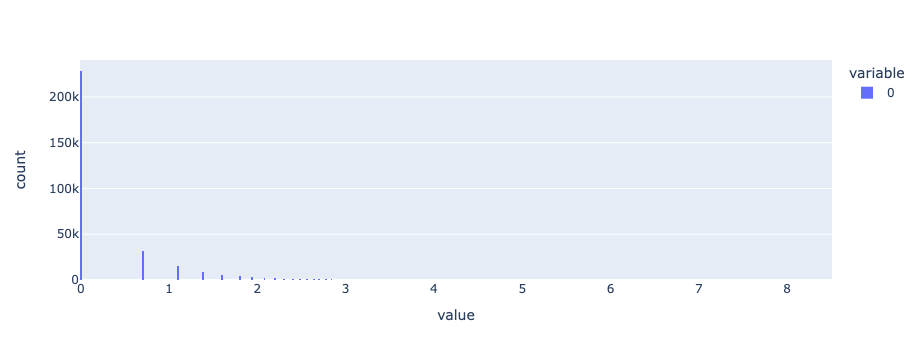

In [167]:
fig = px.histogram(np.log(filtered_ratings))
fig.show()

In [168]:
np.mean(filtered_ratings)

4.7738328119930316

In [169]:
np.max(filtered_ratings)

4881

## Saving subreddits ids

In [170]:
subreddit_id = dict()
id_subreddit = dict()
for i,v in enumerate(final_subreddits):
    subreddit_id[v] = i
    id_subreddit[i] = v

In [171]:
ns_id = dict()
id_ns = dict()
for i,v in enumerate(final_newssources):
    ns_id[v] = i
    id_ns[i] = v

In [172]:
json.dump(subreddit_id, open("subreddit_id.json", "w"), indent=4)
json.dump(id_subreddit, open("id_subreddit.json", "w"), indent=4)

In [173]:
json.dump(ns_id, open("ns_id.json", "w"), indent=4)
json.dump(id_ns, open("id_ns.json", "w"), indent=4)

## saving into .data == too big!

In [105]:
final_dict = yf_df.to_dict()

In [ ]:
# reddit_data = []
# for ns in final_dict:
#     for s in final_dict[ns]:
#         rating = int(final_dict[ns][s])
#         newssource_idx = ns_id[ns]
#         subreddit_idx = subreddit_id[s]
#         reddit_data.append([subreddit_idx, newssource_idx, rating])
        
# json.dump(reddit_data, open("reddit.json", "w"))

In [124]:
reddit_data[:5]

[[0, 0, 247], [1, 0, 4], [2, 0, 2], [3, 0, 38], [4, 0, 199]]

## Saving into `mtx` files 

So I don't have to process every single time.

In [44]:
!pip3 install scipy

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.3/30.3 MB 2.3 MB/s eta 0:00:0000:0100:01


In [49]:
import scipy.sparse as sparse 
import scipy.io as sio 

In [40]:
type(yf)

numpy.ndarray

In [41]:
m = np.asmatrix(yf)

In [47]:
sm = sparse.csr_matrix(m)

In [48]:
sparse.issparse(sm)

True

In [50]:
sio.mmwrite("sparse_matrix.mtx", sm)

# Mapping to 10

In [100]:
sum([r <= 500 for r in ratings])*100/len(ratings)

99.84435505242881

In [74]:
numbers = [r for r in ratings]

In [101]:
new_map = []
for n in numbers:
    if n == 0:
        print("found 0")
    elif n > 0 and n <= 1:
        new_map.append(1)
    elif n > 1 and n <= 5:
        new_map.append(2)
    elif n > 5 and n <= 10:
        new_map.append(3)
    elif n > 10 and n <= 500:
        new_map.append(4)
    elif n > 500:
        new_map.append(5)

In [103]:
def mapto5(n):
    if n > 0 and n <= 1:
        return 1
    elif n > 1 and n <= 5:
        return 2
    elif n > 5 and n <= 10:
        return 3
    elif n > 10 and n <= 500:
        return 4
    elif n > 500:
        return 5

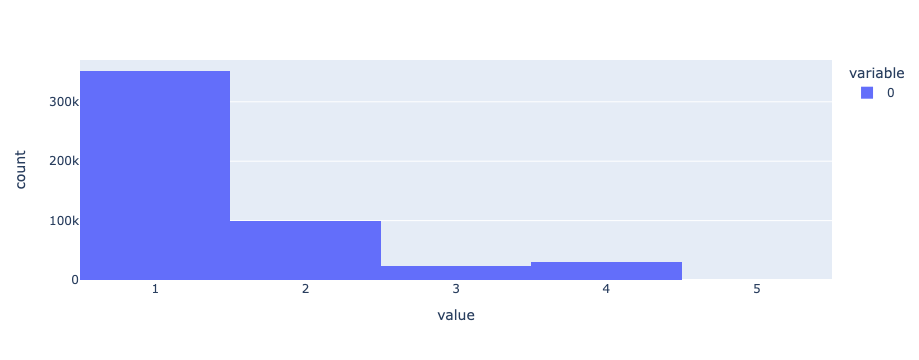

In [102]:
px.histogram(new_map)

In [106]:
month = 1
for path in data_paths:
    new_dict = dict() 
    nssr = json.load(open(path))
    newssources = nssr.keys()
    for ns in newssources:
        subreddits = nssr[ns].keys()
        new_dict[ns] = dict()
        for sr in subreddits:
            new_dict[ns][sr] = mapto5(nssr[ns][sr][0])
    json.dump(new_dict, open(f"data/new{month}.json", "w"), indent=4)
    month += 1
    print(f"done for {path}")

done for data/ns_subreddit_2021-01.json
done for data/ns_subreddit_2021-02.json
done for data/ns_subreddit_2021-03.json
done for data/ns_subreddit_2021-04.json
done for data/ns_subreddit_2021-05.json
done for data/ns_subreddit_2021-06.json


In [107]:
def make_rating_dict():
    print("=== Cleaning data ===")
    current_dict = dict()
    for path in data_paths:
        nssr = json.load(open(path))
        newssources = nssr.keys()
        for ns in newssources:
            subreddits = nssr[ns].keys()
            for sr in subreddits:
                if ns in current_dict and sr in current_dict[ns]:
                    current_dict[ns][sr] += nssr[ns][sr]
                elif ns in current_dict:
                    current_dict[ns][sr] = nssr[ns][sr]
                else:
                    current_dict[ns] = dict()
                    current_dict[ns][sr] = nssr[ns][sr]
        print(f"done for {path}")
    return current_dict

In [108]:
data_paths = ["data/new1.json", "data/new2.json", "data/new3.json", "data/new4.json", "data/new5.json", "data/new6.json",]

In [109]:
current_dict = make_rating_dict()

=== Cleaning data ===
done for data/new1.json
done for data/new2.json
done for data/new3.json
done for data/new4.json
done for data/new5.json
done for data/new6.json


In [110]:
ns_new = list(current_dict.keys())

In [114]:
len(ns_new)

1597

In [115]:
sd_new = set()
for ns in ns_new:
    sd_new = sd_new | set(current_dict[ns].keys())

In [116]:
sd_new

{'Veterans_Hackathon',
 'u_lss_ads_07',
 'u_CalmIndependent213',
 'christianblogs',
 'u_modestvillage',
 'u_homeinsteadwigan',
 'RightWingsOfReddit',
 'tinnitus',
 'PhiloTV',
 'LUCID',
 'u_shenok1234',
 'cyberpunkred',
 'SnapchatXXX',
 'u_lostlad1',
 'DumbassPeopleAtWork',
 'canbyoregon',
 'NewsCritics',
 'u_F1reRa1n',
 'Clan_of_the_Cavebear',
 'MayweathervsPaulLiveF',
 'Heavymind',
 'BenAndJerrys',
 'u_eGOLDpro',
 'bookshelf',
 'nsfwcosplay',
 'FoodNowNow',
 'balkanmusic',
 'AmericanPsycho',
 'SmallMagellanicCloud',
 'PatientWrath',
 'TrueComicBooks',
 'YourRAGE',
 'deadmau5',
 'PaidStudies',
 'u_Confident_Resource89',
 'BollywoodMovieDetails',
 'u_Rixar1333',
 'u_webchungcuhanoi',
 'u_expertjointcare',
 'ShibbySays',
 'elonmusktalks',
 'u_instabooze',
 'BoltEV',
 'u_classonl',
 'u_HaiSanMrD',
 'u_vogueestateagents',
 'CanadaStocks',
 'Tarjoam',
 'Bineal',
 'u_schwansteiger',
 'u_taliastark318',
 'Asphalt8',
 'Oshawott',
 'Nautiluses',
 'AskFDS',
 'puppy101',
 'KittenMittens',
 'u_blo

In [117]:
df.head()

,wikipedia.org,espn.com,yahoo.com,reuters.com,sbs.com.au,cnn.com,engadget.com,blogspot.com,rt.com,theatlantic.com,...,dbrnews.com,theskimm.com,foxreno.com,sunlightfoundation.com,muncievoice.com,the-daily.buzz,thetowntalk.com,sonorannews.com,worldpress.org,conservativefreepress.com
RidiculousKanji,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
teslamotors,13.0,0.0,35.0,38.0,0.0,17.0,12.0,23.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
u_Mondevana,4.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
phish,4.0,0.0,3.0,0.0,0.0,0.0,0.0,9.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
footballmanagergames,4.0,2.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [119]:
list(df.columns)

['wikipedia.org',
 'espn.com',
 'yahoo.com',
 'reuters.com',
 'sbs.com.au',
 'cnn.com',
 'engadget.com',
 'blogspot.com',
 'rt.com',
 'theatlantic.com',
 'breitbart.com',
 'newrepublic.com',
 'businessinsider.com',
 'bostonglobe.com',
 'washingtontimes.com',
 'cnbc.com',
 'sky.com',
 'cbsnews.com',
 'npr.org',
 'theguardian.com',
 'aljazeera.com',
 'apnews.com',
 'sciencealert.com',
 'thestar.com',
 'cbc.ca',
 'nytimes.com',
 'arstechnica.com',
 'abc.net.au',
 'theverge.com',
 'bbc.com',
 'bloomberg.com',
 'bangkokpost.com',
 'smh.com.au',
 'go.com',
 'foxnews.com',
 'nbcnews.com',
 'politico.com',
 'wnd.com',
 'globalnews.ca',
 'timesofisrael.com',
 'washingtonexaminer.com',
 'scientificamerican.com',
 'usatoday.com',
 'clickondetroit.com',
 'indiatimes.com',
 'scmp.com',
 'denverpost.com',
 'thehill.com',
 'deadline.com',
 'fool.com',
 'cbslocal.com',
 'sun-sentinel.com',
 'truthout.org',
 'sfchronicle.com',
 'techcrunch.com',
 'triblive.com',
 'dispatch.com',
 'wordpress.com',
 'fox

## PMF